In [1]:
import pandas as pd
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import cv2
import os

**Import a MNIST dataset**

In [ ]:
from keras.datasets import mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()

x_train = x_train.astype('float32')/ 255
x_test  = x_test.astype( 'float32')/ 255
x_train = x_train.reshape((len(x_train), np.prod(x_train.shape[1:])))
x_test  = x_test.reshape( (len(x_test),  np.prod(x_test.shape[1:])))

11490434/11490434 [==============================] - 0s 0us/step


**Activation Class**

In [2]:
class Activation_ReLU:
  def __init__(self):
    self.input=[]
    self.output=[]
    self.dinputs=[]

  def forward(self, input):
    self.input = input
    self.output=np.maximum(0, input)

  def backward(self, dvalues):
    dvalues = np.sum(dvalues, axis=0, keepdims=True)
    self.dinputs=dvalues*np.where(self.output > 0, 1, 0)

class Activation_LakyReLU:
  def __init__(self):
    self.input=[]
    self.output=[]
    self.dinputs=[]

  def forward(self, input):
    self.input = input
    self.output=np.maximum(0.01*input, input)

  def backward(self, dvalues):
    dvalues = np.sum(dvalues, axis=0, keepdims=True)
    self.dinputs=(dvalues >= 0) * 1 + (dvalues < 0) * 0.01

class Activation_Sigmoid:
  def __init__(self):
    self.input=[]
    self.output=[]
    self.dinputs=[]

  def forward(self, input):
    self.output = 1 / (1 + np.exp(-input))

  def backward(self, dvalues):
    self.dinputs = dvalues * (1 - self.output) * self.output


class Activation_Tanh:
  def __init__(self):
    self.input=[]
    self.output=[]
    self.dinputs=[]

  def forward(self, input):
    self.input=input
    self.output = np.tanh(input)

  def backward(self, dvalues):
    self.dinputs = dvalues * (1-np.tanh(self.input)**2)

**Dense Class**

In [3]:
class Dense:
  def __init__(self, input_dim, neurons):

    self.weights=0.1*np.random.randn(input_dim, neurons)
    self.biases=np.zeros((1, neurons))
    self.input=[]
    self.output=[]
    self.dweights=0
    self.dbiases=0
    self.dinputs=0

  def  forward(self, input):
    self.input=input
    self.output=np.dot(self.input, self.weights)+self.biases

  def backward(self, dvalues):
    self.dbiases=dvalues
    if self.input.shape[0]!=1:
        self.input=self.input.reshape(1, -1)
    self.dweights=np.dot(self.input.T,dvalues)
    self.dinputs=np.dot(dvalues, self.weights.T)

**Generator**

In [126]:
class Generator:
  def __init__(self, latent_dim, intermediate_dim, output_dim):
    self.layer1=Dense(latent_dim, intermediate_dim)
    self.layer1Activation=Activation_ReLU()
    self.layer2=Dense(intermediate_dim, output_dim)
    self.layer2Activation=Activation_Sigmoid()#Tanh()
    self.trinable_layers=[self.layer1, self.layer2]
    self.optimizer=Optimizer_Adam(learning_rate=0.001)

  def generate(self, input):
    self.layer1.forward(input)
    self.layer1Activation.forward(self.layer1.output)


    self.layer2.forward(self.layer1Activation.output)
    self.layer2Activation.forward(self.layer2.output)

    return self.layer2Activation.output

  def backward(self, loss, optimize=False):
    self.layer2Activation.backward(loss)
    self.layer2.backward(self.layer2Activation.dinputs)
    self.layer1Activation.backward(self.layer2.dinputs)
    self.layer1.backward(self.layer1Activation.dinputs)
    if optimize:
      self.optimize()

  def optimize(self):
    self.optimizer.pre_update_params()
    for layer in (self.trinable_layers):
      self.optimizer.update_params(layer)
    self.optimizer.post_update_params()

**Discriminator**

In [5]:
class Discriminator:
  def __init__(self, input_dim, intermediate_dim, output_dim):
    self.layer1=Dense(input_dim, intermediate_dim)
    self.layer1Activation=Activation_ReLU()
    self.layer2=Dense(intermediate_dim, output_dim)
    self.layer2Activation=Activation_Sigmoid()
    self.trainable_layers=[self.layer1, self.layer2]
    self.optimizer=Optimizer_Adam(learning_rate=0.0002)

  def discriminate(self, input):
    self.layer1.forward(input)
    self.layer1Activation.forward(self.layer1.output)

    self.layer2.forward(self.layer1Activation.output)
    self.layer2Activation.forward(self.layer2.output)

    return self.layer2Activation.output

  def backward(self, loss, optimize=False):
    self.layer2Activation.backward(loss)
    self.layer2.backward(self.layer2Activation.dinputs)
    self.layer1Activation.backward(self.layer2.dinputs)
    self.layer1.backward(self.layer1Activation.dinputs)
    if optimize:
      self.optimize()

  def optimize(self):
    self.optimizer.pre_update_params()
    for layer in (self.trainable_layers):
      self.optimizer.update_params(layer)
    self.optimizer.post_update_params()

**Carga de imagenes de rostros (Son volatiles)**

In [6]:
images=os.listdir('./faces/normal_resolution')
low_images=os.listdir('./faces/low_resolution')
#images.remove('.ipynb_checkpoints')
#low_images.remove('.ipynb_checkpoints')

In [7]:
for i in range(len(images)):
  images[i]=cv2.imread('./faces/normal_resolution/'+images[i],0)
  low_images[i]=cv2.imread('./faces/low_resolution/'+low_images[i],0)

In [8]:
for i in range(len(images)):
  images[i]=np.array(images[i]).reshape(1,-1)
  images[i]=images[i].astype('float32')/255
  low_images[i]=np.array(low_images[i]).reshape(1,-1)
  low_images[i]=low_images[i].astype('float32')/255

**Creación de un Autoencoder para la mejora de resolución**

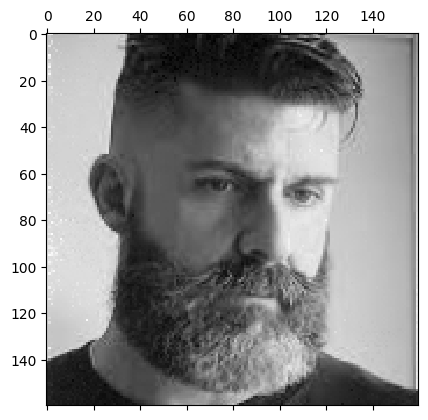

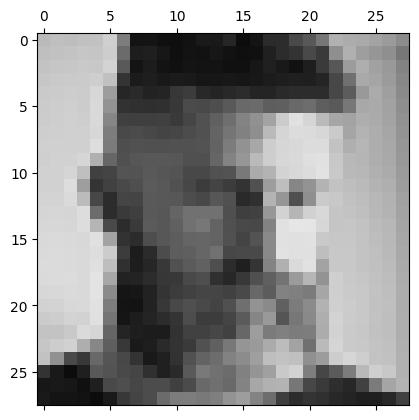

In [128]:
#test generator
latent_dim=784
intermediate_dim=200
output_dim=25600

#generator=Generator(latent_dim, intermediate_dim, output_dim)
#for j in range(150):
#  for i in range(8):
#    generated_data=generator.generate(low_images[i])
#    loss=generated_data-images[i]
#    generator.backward(loss, optimize=True)
number=5
generated_data=generator.generate(low_images[number])
plt.matshow(generated_data.reshape((160,160)), cmap='gray', clim=(0,1))
plt.matshow(low_images[number].reshape((28,28)), cmap='gray', clim=(0,1))

**Prueba de que nuestro discriminador funcione bien**

In [ ]:
#test generator
input_dim=784
intermediate_dim=200
output_dim=1

discriminator=Discriminator(input_dim, intermediate_dim, output_dim)
generator2=Generator(2,200,784)
#generated_data=generator.generate(np.random.normal(0, 1, size=(1,2)))
#plt.matshow(generated_data.reshape((28,28)), cmap='Purples_r', clim=(0,1))
for i in range(50):
  for img in x_train[0:10]:
    discriminated_data=discriminator.discriminate(img)
    loss=discriminated_data-np.array([1])#lossFunction.forward(discriminated_data,np.array([1,1]))
    print("real_prediction: ", discriminated_data)
    discriminator.backward(loss, optimize=True)
    fake_img=generator2.generate(np.random.normal(0,1, size=(1,2)))
    discriminated_fakedata=discriminator.discriminate(fake_img)
    print("fake_prediction: ", discriminated_fakedata)
    loss=discriminated_fakedata#lossFunction.forward(discriminated_fakedata,np.array([0,0]))
    discriminator.backward(loss, optimize=True)#[0][0])#-np.log(discriminated_data[0][0])-np.log(1-discriminated_fakedata[0][0]))
#for i in range(50):
    #fake_img=generator.generate(np.random.normal(0,1, size=(1,2)))
data=discriminator.discriminate(generator.generate(x_train[9]))
print(data)#-np.array([1,0])
    #generator.backward(1-loss[0][0])


real_prediction:  [[0.72019103]]
fake_prediction:  [[0.77653873]]
real_prediction:  [[0.78777439]]
fake_prediction:  [[0.63864237]]
real_prediction:  [[0.62759882]]
fake_prediction:  [[0.45669772]]
real_prediction:  [[0.74449429]]
fake_prediction:  [[0.28394555]]
real_prediction:  [[0.85758273]]
fake_prediction:  [[0.21082687]]
real_prediction:  [[0.84480963]]
fake_prediction:  [[0.12929287]]
real_prediction:  [[0.68584003]]
fake_prediction:  [[0.08722542]]
real_prediction:  [[0.82208363]]
fake_prediction:  [[0.06240658]]
real_prediction:  [[0.67353657]]
fake_prediction:  [[0.05074328]]
real_prediction:  [[0.74610457]]
fake_prediction:  [[0.04118043]]
real_prediction:  [[0.77366774]]
fake_prediction:  [[0.03458019]]
real_prediction:  [[0.77693286]]
fake_prediction:  [[0.03340143]]
real_prediction:  [[0.65198754]]
fake_prediction:  [[0.02893851]]
real_prediction:  [[0.76788886]]
fake_prediction:  [[0.02810496]]
real_prediction:  [[0.88619289]]
fake_prediction:  [[0.02652464]]
real_predi

**Function Loss**

In [10]:
class LossBinaryCrossEntropy():
  def forward(self, y_pred, y_true):
    y_pred_clipped = np.clip(y_pred, 1e-7, 1 - 1e-7)

    sample_losses = -(y_true * np.log(y_pred_clipped) + (1 - y_true) * np.log(1 - y_pred_clipped))
    #sample_losses = np.mean(sample_losses, axis=1)

    return sample_losses

  def backward(self, dvalues, y_true):
    samples = len(dvalues)
    outputs = len(dvalues[0])

    clipped_dvalues = np.clip(dvalues, 1e-7, 1 - 1e-7)

    self.dinputs = -(y_true / clipped_dvalues - (1 - y_true)
                     /(1 - clipped_dvalues))/outputs

    self.dinputs = self.dinputs / samples

**Optimizer**

In [11]:
class Optimizer_Adam:
  def __init__(self, learning_rate=0.01, decay=0., epsilon=1e-7,beta_1=0.9, beta_2=0.999):
    self.learning_rate = learning_rate
    self.current_learning_rate = learning_rate
    self.decay = decay
    self.iterations = 0
    self.epsilon = epsilon
    self.beta_1 = beta_1
    self.beta_2 = beta_2


  def pre_update_params(self):
    if self.decay:
      self.current_learning_rate = self.learning_rate * (1. / (1. + self.decay * self.iterations))

  def update_params(self, layer):
    if not hasattr(layer, 'weight_cache'):
      layer.weight_momentums = np.zeros_like(layer.weights)
      layer.weight_cache = np.zeros_like(layer.weights)
      layer.bias_momentums = np.zeros_like(layer.biases)
      layer.bias_cache = np.zeros_like(layer.biases)

    # Update momentum with current gradients
    layer.weight_momentums = self.beta_1 * layer.weight_momentums + (1 - self.beta_1) * layer.dweights
    layer.bias_momentums = self.beta_1 * layer.bias_momentums + (1 - self.beta_1) * layer.dbiases
    # Get corrected momentum
    # self.iteration is 0 at first pass
    # and we need to start with 1 here
    weight_momentums_corrected = layer.weight_momentums / (1 - self.beta_1 ** (self.iterations + 1))
    bias_momentums_corrected = layer.bias_momentums / (1 - self.beta_1 ** (self.iterations + 1))
    # Update cache with squared current gradients
    layer.weight_cache = self.beta_2 * layer.weight_cache + (1 - self.beta_2) * layer.dweights**2
    layer.bias_cache = self.beta_2 * layer.bias_cache + (1 - self.beta_2) * layer.dbiases**2
    # Get corrected cache
    weight_cache_corrected = layer.weight_cache / (1 - self.beta_2 ** (self.iterations + 1))
    bias_cache_corrected = layer.bias_cache / (1 - self.beta_2 ** (self.iterations + 1))
    # Vanilla SGD parameter update + normalization
    # with square rooted cache
    layer.weights += -self.current_learning_rate * weight_momentums_corrected / (np.sqrt(weight_cache_corrected) + self.epsilon)
    layer.biases += -self.current_learning_rate * bias_momentums_corrected / (np.sqrt(bias_cache_corrected) + self.epsilon)

  # Call once after any parameter updates
  def post_update_params(self):
    self.iterations += 1

**GAN**

In [48]:
class GAN:
  def __init__(self, generator, discriminator):
    self.generator=generator
    self.discriminator=discriminator
    self.lossFunction=LossBinaryCrossEntropy()

  def fit(self, data_train, epoch, batch):
    for i in range(epoch):
      print("epoch",i)
      start_batch=0
      steps=int(len(data_train)/batch)
      for step in range(steps):
        limit_batch=(step+1)*int(len(data_train)/steps)
        print("start: ", start_batch, " end: ", limit_batch)
        for data in data_train[start_batch:limit_batch]:
          sample_z = np.random.normal(0, 1, size=(1,self.generator.layer1.weights.shape[0]))
          fake_image=self.generator.generate(sample_z)

          discriminated_data=self.discriminator.discriminate(data)
          loss=discriminated_data-np.array([1])#lossFunction.forward(discriminated_data,np.array([1,1]))
          self.discriminator.backward(loss, optimize=True)

          discriminated_fakedata=self.discriminator.discriminate(fake_image)
          loss=discriminated_fakedata#lossFunction.forward(discriminated_fakedata,np.array([0,0]))
          self.discriminator.backward(loss, optimize=True)

          sample_z = np.random.normal(0, 1, size=(1,self.generator.layer1.weights.shape[0]))
          fake_image=self.generator.generate(sample_z)
          discriminated_data=self.discriminator.discriminate(fake_image)
          print(discriminated_data)
          loss=discriminated_data-np.array([1])
          self.discriminator.backward(loss)
          self.generator.backward(self.discriminator.layer1.dinputs, optimize=True)
        start_batch=limit_batch

**Entrenamiento con el Dataset de MNIST**

In [ ]:
d_input_dim=784
d_intermediate_dim=200
d_output_dim=1
GAN_discriminator=Discriminator(d_input_dim, d_intermediate_dim, d_output_dim)

g_latent_dim=2
g_intermediate_dim=200
g_output_dim=784

GAN_generator=Generator(g_latent_dim, g_intermediate_dim, g_output_dim)





In [ ]:
modelGAN=GAN(GAN_generator, GAN_discriminator)
modelGAN.fit(x_train[0:30], 1000, 10)

Se truncaron las últimas líneas 5000 del resultado de transmisión.
[[0.03825515]]
[[0.00120989]]
epoch 853
start:  0  end:  10
[[0.09325525]]
[[0.00884434]]
[[0.08287382]]
[[0.0850879]]
[[0.02485224]]
[[0.05459816]]
[[0.06629968]]
[[0.04854633]]
[[0.03379873]]
[[0.07242534]]
start:  10  end:  20
[[0.09748544]]
[[0.11503505]]
[[0.08767213]]
[[0.02508458]]
[[0.06818945]]
[[0.10503676]]
[[0.08957832]]
[[0.1292267]]
[[0.16048964]]
[[0.12610618]]
start:  20  end:  30
[[0.28282142]]
[[0.06762031]]
[[0.01828715]]
[[0.08472177]]
[[0.1198012]]
[[0.28002441]]
[[0.10971947]]
[[0.24420323]]
[[0.0538141]]
[[0.08108563]]
epoch 854
start:  0  end:  10
[[0.056453]]
[[0.07276812]]
[[0.00378049]]
[[0.05687243]]
[[0.08175809]]
[[0.04821275]]
[[0.07528381]]
[[0.09268014]]
[[0.10109533]]
[[0.51017659]]
start:  10  end:  20
[[0.12396982]]
[[0.18940574]]
[[0.12900619]]
[[0.12581674]]
[[0.11857615]]
[[0.2255567]]
[[0.00509426]]
[[0.1146393]]
[[0.20859323]]
[[0.0117397]]
start:  20  end:  30
[[0.04089657]]
[[0

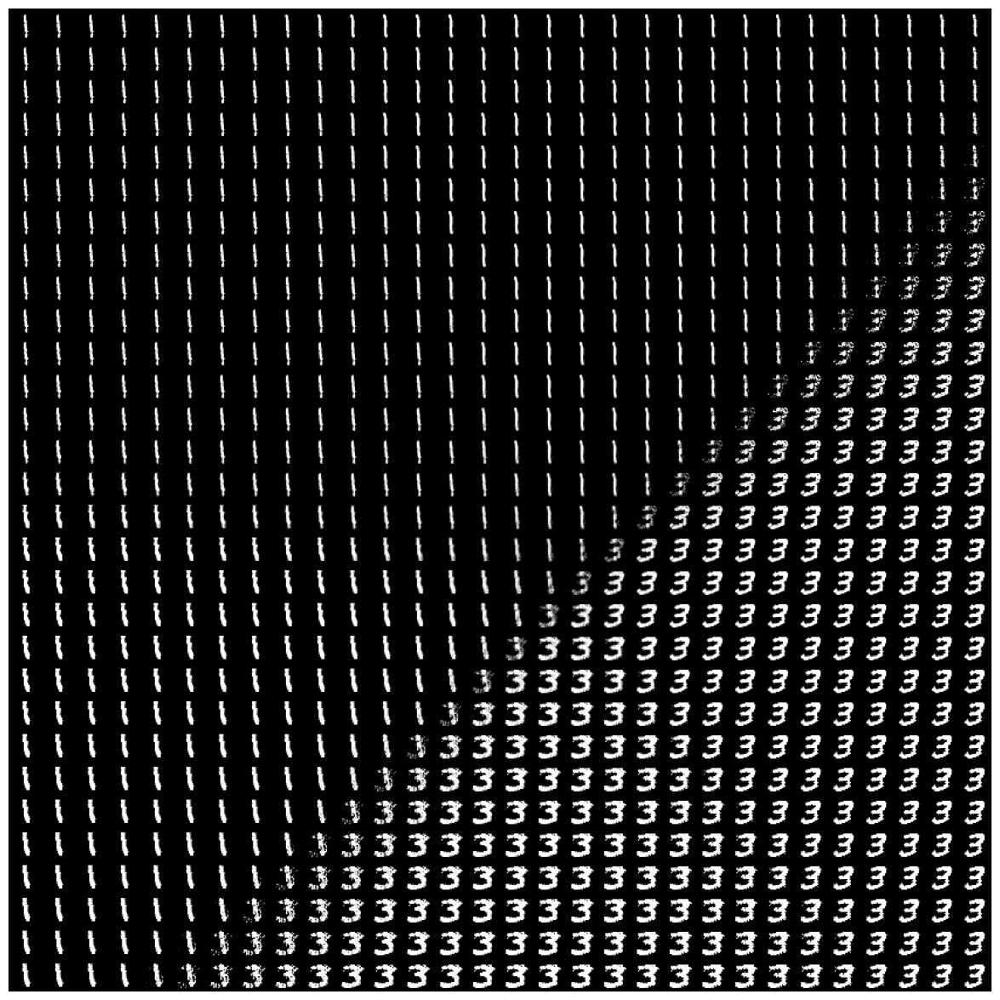

In [ ]:
numImgs = 30
newrows,newcols=28,28
lo, hi  = -3.,3.

z1 = np.linspace(lo, hi, numImgs)
z2 = np.linspace(lo, hi, numImgs)

import matplotlib.pyplot as plt

plt.figure(figsize=(15,15*newcols/newrows))
canvas=np.zeros((newrows*numImgs,newcols*numImgs))
for i in range(numImgs):
    for j in range(numImgs):
        z=np.array([z1[i], z2[j]])
        z=np.expand_dims(z, axis=0)
        Im=modelGAN.generator.generate(z)
        canvas[newrows*i:newrows*(i+1), newcols*j:newcols*(j+1)] = Im.reshape((newrows,newcols))

plt.imshow(canvas, 'gray')
plt.axis('off')
plt.show()
#plt.matshow(generator.generate(np.random.normal(0,1, size=(1,2))).reshape(28,28))

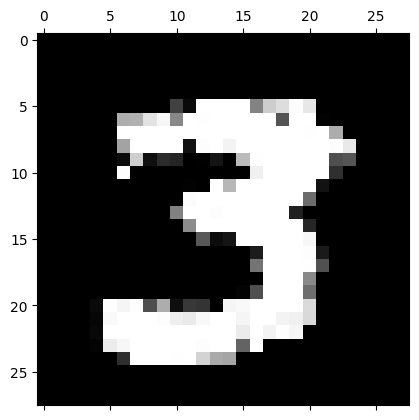

In [ ]:
plt.matshow(modelGAN.generator.generate(np.random.normal(0,1, size=(1,2))).reshape(28,28), cmap='gray')

**Probando con otras imagenes**

In [ ]:
!git clone https://github.com/FaustineLi/Variational-Autoencoders.git

Cloning into 'Variational-Autoencoders'...
remote: Enumerating objects: 247, done.
remote: Total 247 (delta 0), reused 0 (delta 0), pack-reused 247
Receiving objects: 100% (247/247), 24.04 MiB | 25.92 MiB/s, done.
Resolving deltas: 100% (109/109), done.


In [ ]:
cd /content

/content


In [ ]:
cd Variational-Autoencoders/

/content/Variational-Autoencoders


In [ ]:
import scipy.io
sil = scipy.io.loadmat('./resources/data/caltech101_16.mat')
silX = sil['X']
silY = sil['Y']
silX_train = silX[np.where(sil['Y'] == 87)[1],:][0:80,:]
silX_test  = silX[np.where(sil['Y'] == 87)[1],:][81:,:]

In [ ]:
d_input_dim=256
d_intermediate_dim=200
d_output_dim=1
GAN_discriminator=Discriminator(d_input_dim, d_intermediate_dim, d_output_dim)

g_latent_dim=2
g_intermediate_dim=200
g_output_dim=256

GAN_generator=Generator(g_latent_dim, g_intermediate_dim, g_output_dim)


In [ ]:
modelGAN=GAN(GAN_generator, GAN_discriminator)
modelGAN.fit(silX_train[0:30], 1000, 10)

Se truncaron las últimas líneas 5000 del resultado de transmisión.
[[0.12881592]]
[[0.0511681]]
epoch 853
start:  0  end:  10
[[0.09081106]]
[[0.0699625]]
[[0.09418264]]
[[0.06780747]]
[[0.04243385]]
[[0.08918925]]
[[0.1347024]]
[[0.20797709]]
[[0.09611567]]
[[0.09290183]]
start:  10  end:  20
[[0.11615752]]
[[0.03027371]]
[[0.04467777]]
[[0.21802405]]
[[0.20790874]]
[[0.24628137]]
[[0.26750544]]
[[0.03121875]]
[[0.02886368]]
[[0.17906326]]
start:  20  end:  30
[[0.19893626]]
[[0.10915284]]
[[0.35805862]]
[[0.25315867]]
[[0.14709874]]
[[0.12888149]]
[[0.10108177]]
[[0.1440377]]
[[0.11458825]]
[[0.10549257]]
epoch 854
start:  0  end:  10
[[0.13890311]]
[[0.03536398]]
[[0.05998951]]
[[0.104499]]
[[0.0480964]]
[[0.1231035]]
[[0.06537747]]
[[0.13605348]]
[[0.01512374]]
[[0.06410211]]
start:  10  end:  20
[[0.12997805]]
[[0.1197547]]
[[0.14355371]]
[[0.28910481]]
[[0.19192169]]
[[0.33231634]]
[[0.04397437]]
[[0.31189432]]
[[0.31598158]]
[[0.51486446]]
start:  20  end:  30
[[0.29669858]]
[[0

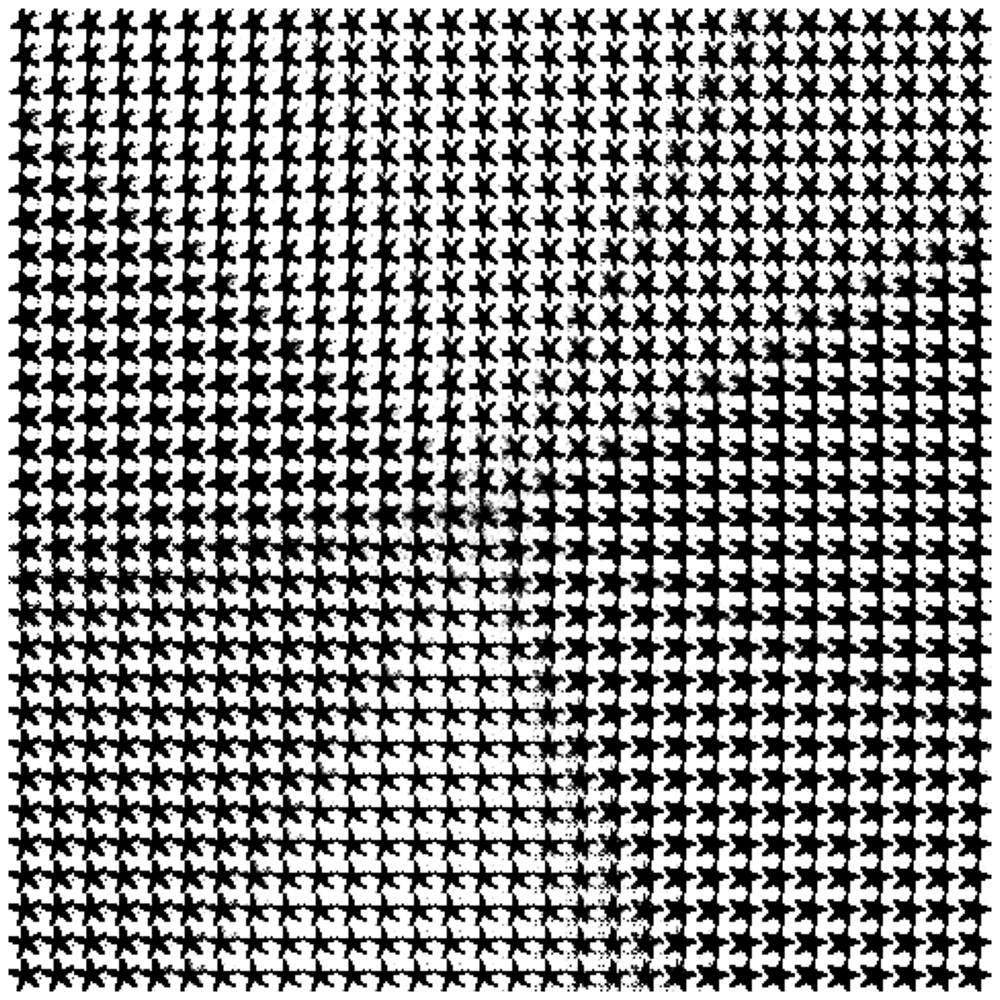

In [ ]:
numImgs = 30
newrows,newcols=16,16
lo, hi  = -3.,3.

z1 = np.linspace(lo, hi, numImgs)
z2 = np.linspace(lo, hi, numImgs)

import matplotlib.pyplot as plt

plt.figure(figsize=(15,15*newcols/newrows))
canvas=np.zeros((newrows*numImgs,newcols*numImgs))
for i in range(numImgs):
    for j in range(numImgs):
        z=np.array([z1[i], z2[j]])
        z=np.expand_dims(z, axis=0)
        Im=modelGAN.generator.generate(z)
        canvas[newrows*i:newrows*(i+1), newcols*j:newcols*(j+1)] = Im.reshape((newrows,newcols))

plt.imshow(canvas, 'gray')
plt.axis('off')
plt.show()

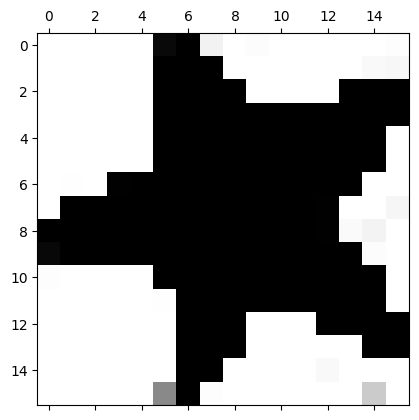

In [ ]:
plt.matshow(modelGAN.generator.generate(np.random.normal(0,1, size=(1,2))).reshape(16,16), cmap='gray')

**Prueba con el dataset FASHION**

In [ ]:
from keras.datasets import fashion_mnist
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

x_train = x_train.astype('float32')/ 255
x_test  = x_test.astype( 'float32')/ 255
x_train = x_train.reshape((len(x_train), np.prod(x_train.shape[1:])))
x_test  = x_test.reshape( (len(x_test),  np.prod(x_test.shape[1:])))

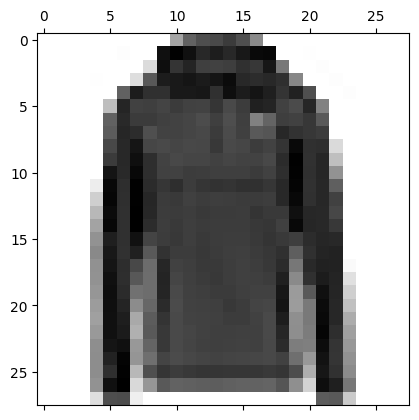

In [ ]:
plt.matshow(x_train[24].reshape(28,28), cmap="gray_r")

In [ ]:
d_input_dim=784
d_intermediate_dim=200
d_output_dim=1
GAN_discriminator=Discriminator(d_input_dim, d_intermediate_dim, d_output_dim)

g_latent_dim=2
g_intermediate_dim=200
g_output_dim=784

GAN_generator=Generator(g_latent_dim, g_intermediate_dim, g_output_dim)

In [ ]:
modelGAN=GAN(GAN_generator, GAN_discriminator)
modelGAN.fit(x_train[0:30], 1000, 10)

Se truncaron las últimas líneas 5000 del resultado de transmisión.
[[0.2131999]]
[[0.22167162]]
epoch 853
start:  0  end:  10
[[0.7760936]]
[[0.04845654]]
[[0.10518391]]
[[0.55206082]]
[[0.00067232]]
[[0.07268938]]
[[0.00156563]]
[[0.03937804]]
[[0.00180956]]
[[0.12475739]]
start:  10  end:  20
[[0.03474365]]
[[0.04824715]]
[[0.07773017]]
[[0.00537606]]
[[0.00053248]]
[[0.02027361]]
[[0.05287267]]
[[0.00354359]]
[[0.00040195]]
[[0.01044588]]
start:  20  end:  30
[[0.06646165]]
[[0.02203129]]
[[0.01679202]]
[[0.02561075]]
[[0.25421217]]
[[0.03251837]]
[[0.28266555]]
[[0.35597419]]
[[0.49574113]]
[[0.60289862]]
epoch 854
start:  0  end:  10
[[0.93544973]]
[[0.14511574]]
[[0.34555053]]
[[0.82101406]]
[[0.07058181]]
[[0.04579697]]
[[0.12556846]]
[[0.34413615]]
[[0.0333208]]
[[0.43056765]]
start:  10  end:  20
[[0.0337539]]
[[0.00774184]]
[[0.01867322]]
[[0.00106703]]
[[0.00028363]]
[[0.00232262]]
[[0.006713]]
[[0.01320196]]
[[0.00911769]]
[[0.00682593]]
start:  20  end:  30
[[0.00150713]]


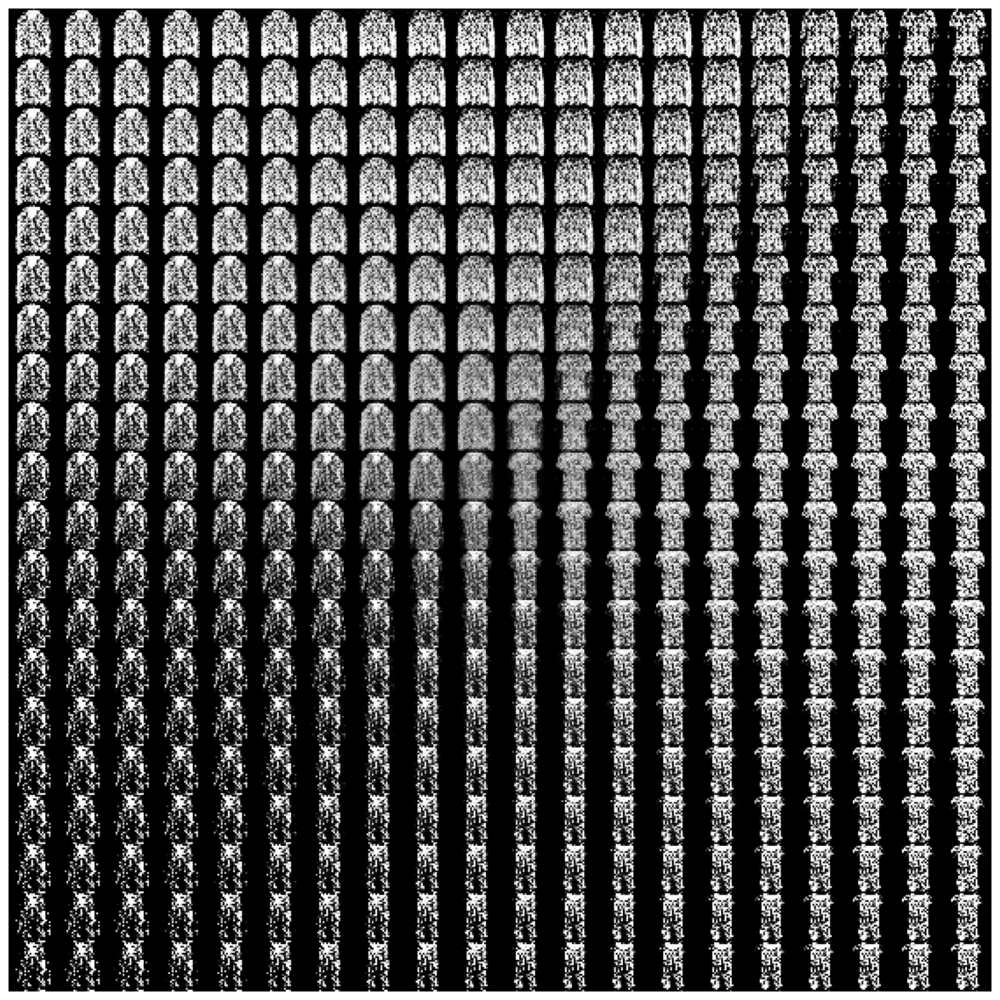

In [ ]:
numImgs = 20
newrows,newcols=28,28
lo, hi  = -3.,3.

z1 = np.linspace(lo, hi, numImgs)
z2 = np.linspace(lo, hi, numImgs)

import matplotlib.pyplot as plt

plt.figure(figsize=(15,15*newcols/newrows))
canvas=np.zeros((newrows*numImgs,newcols*numImgs))
for i in range(numImgs):
    for j in range(numImgs):
        z=np.array([z1[i], z2[j]])
        z=np.expand_dims(z, axis=0)
        Im=modelGAN.generator.generate(z)
        canvas[newrows*i:newrows*(i+1), newcols*j:newcols*(j+1)] = Im.reshape((newrows,newcols))

plt.imshow(canvas, 'gray')
plt.axis('off')
plt.show()

**Prueba con los rostros cargados previamente**

In [141]:
d_input_dim=784
d_intermediate_dim=200
d_output_dim=1
GAN_discriminator=Discriminator(d_input_dim, d_intermediate_dim, d_output_dim)

g_latent_dim=2
g_intermediate_dim=200
g_output_dim=784

GAN_generator=Generator(g_latent_dim, g_intermediate_dim, g_output_dim)

In [142]:
modelGAN=GAN(GAN_generator, GAN_discriminator)
modelGAN.fit(low_images[0:8], 1000, 2)

Se truncaron las últimas líneas 5000 del resultado de transmisión.
[[0.10400981]]
[[0.57741261]]
start:  4  end:  6
[[0.57540175]]
[[0.05628901]]
start:  6  end:  8
[[0.02624597]]
[[0.44495369]]
epoch 616
start:  0  end:  2
[[0.04597314]]
[[0.12228579]]
start:  2  end:  4
[[0.29424392]]
[[0.27628874]]
start:  4  end:  6
[[0.21919423]]
[[0.12434823]]
start:  6  end:  8
[[0.18198019]]
[[0.13090634]]
epoch 617
start:  0  end:  2
[[0.3718698]]
[[0.54606604]]
start:  2  end:  4
[[0.58318861]]
[[0.19036065]]
start:  4  end:  6
[[0.39238199]]
[[0.06781773]]
start:  6  end:  8
[[0.25460532]]
[[0.156937]]
epoch 618
start:  0  end:  2
[[0.0678427]]
[[0.28123134]]
start:  2  end:  4
[[0.08503547]]
[[0.81050654]]
start:  4  end:  6
[[0.54332086]]
[[0.41493089]]
start:  6  end:  8
[[0.15342873]]
[[0.47049794]]
epoch 619
start:  0  end:  2
[[0.81018933]]
[[0.14323281]]
start:  2  end:  4
[[0.05477895]]
[[0.12523022]]
start:  4  end:  6
[[0.5482727]]
[[0.07240807]]
start:  6  end:  8
[[0.41983842]]
[

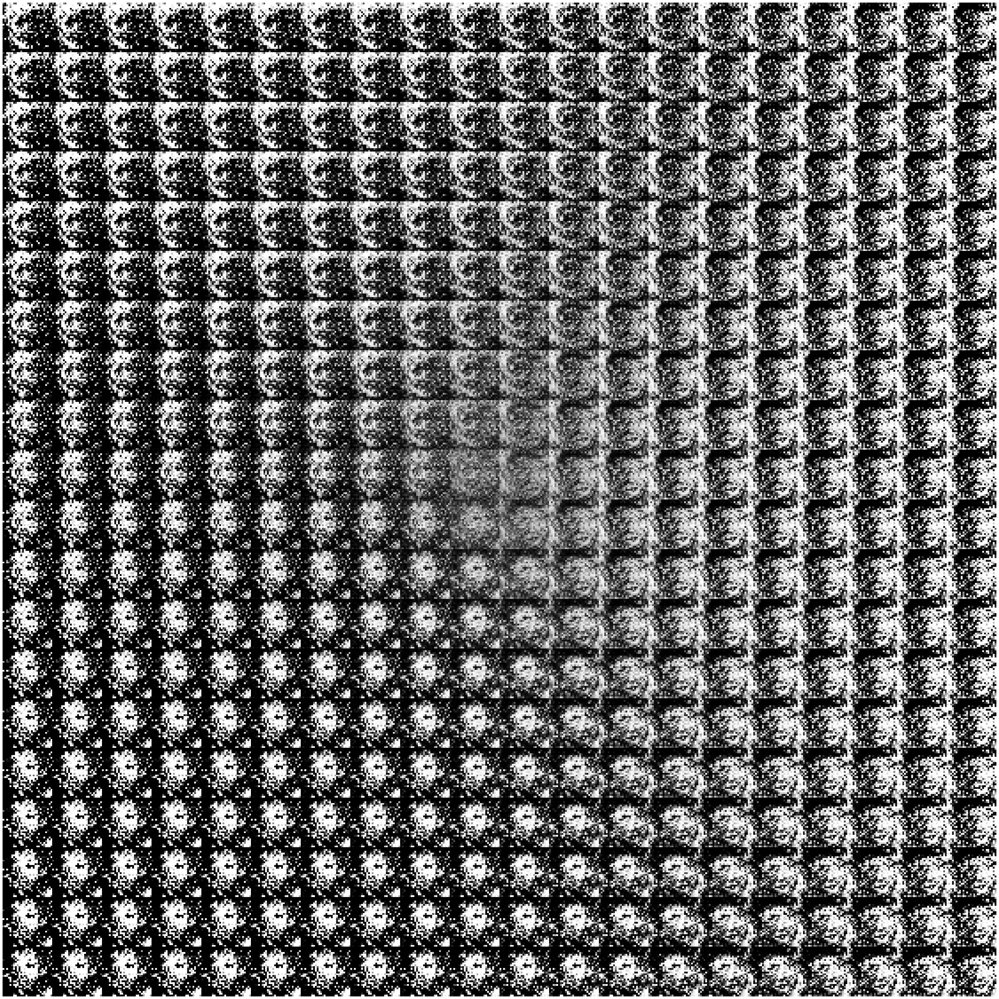

In [143]:
numImgs = 20
newrows,newcols=28,28
lo, hi  = -3.,3.

z1 = np.linspace(lo, hi, numImgs)
z2 = np.linspace(lo, hi, numImgs)

import matplotlib.pyplot as plt

plt.figure(figsize=(50,50*newcols/newrows))
canvas=np.zeros((newrows*numImgs,newcols*numImgs))
for i in range(numImgs):
    for j in range(numImgs):
        z=np.array([z1[i], z2[j]])
        z=np.expand_dims(z, axis=0)
        Im=modelGAN.generator.generate(z)
        canvas[newrows*i:newrows*(i+1), newcols*j:newcols*(j+1)] = Im.reshape((newrows,newcols))

plt.imshow(canvas, 'gray')
plt.axis('off')
plt.show()

**Mejora de resolución con ayuda del Autoencoder entrenado previamente**

In [144]:
numImgs = 20
lo, hi  = -3.,3.

z1 = np.linspace(lo, hi, numImgs)
z2 = np.linspace(lo, hi, numImgs)

images_generated=[]

for i in range(numImgs):
    for j in range(numImgs):
        z=np.array([z1[i], z2[j]])
        z=np.expand_dims(z, axis=0)
        images_generated.append(modelGAN.generator.generate(z))




In [145]:
images_generated_by_resolution=[]

for img in images_generated:
  images_generated_by_resolution.append(generator.generate(img))

images_generated_by_resolution=np.array(images_generated_by_resolution).reshape(400,25600).reshape(20,20,25600)

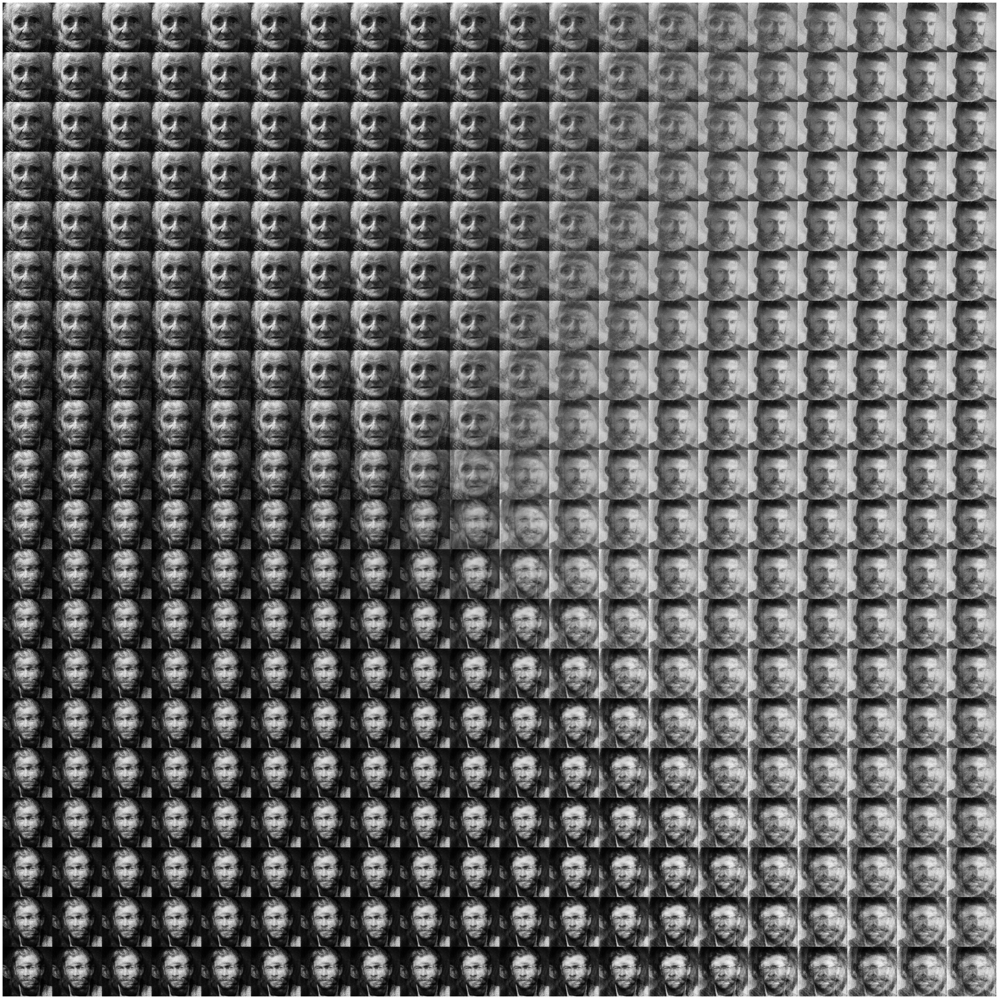

In [146]:
numImgs = 20
newrows,newcols=160,160


import matplotlib.pyplot as plt

plt.figure(figsize=(50,50*newcols/newrows))
canvas=np.zeros((newrows*numImgs,newcols*numImgs))
for i in range(numImgs):
    for j in range(numImgs):
        canvas[newrows*i:newrows*(i+1), newcols*j:newcols*(j+1)] = images_generated_by_resolution[i][j].reshape(newrows,newcols)

plt.imshow(canvas, 'gray')
plt.axis('off')
plt.show()